<font size="10" color="DarkSlateGray"><b>Simple Road Follower</b></font>

This notebook accompanies the Medium article [**“A Modern Workflow for ROS Development Using Google Colab and Foxglove”**](https://medium.com/@engelwilliam97/)


<img src="https://drive.google.com/uc?export=view&id=1u71bvuqnuzD8EgT6Jqq6frWwM7W1PnHP" width="1000">

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import glob

## ℹ️ How to use the Colab notebook

### 1) Connections

In the **Connections** section, the notebook is linked to both **Google Drive** and **Foxglove Cloud**.

* **Connect to Google Drive**
  Update the path so it points to your own workspace inside Google Drive. This is where datasets and exported files will be stored.

* **Connect to Foxglove**
  Set your **Foxglove API key** in Google Colab **Secrets**. Once this is done, the *Connect to Foxglove* cell can access your Foxglove recordings via Foxflow.

---

### 2) Getting the data into Colab

In **Streaming Foxglove data into Colab**, you have two options:

#### Option A — Stream from Foxglove Cloud

If you have already uploaded the bagfiles from the dataset to your Foxglove account, choose:

**Streaming and Synchronizing Data from Foxglove Cloud**

Dataset:
[Foxglove Upload Dataset — Click here](https://drive.google.com/drive/folders/1geoIokdVgPSvhJAprPLJ8nnJGFBzr5nF)

Foxflow will pull the data directly from Foxglove into Colab.

#### Option B — Load from Google Drive

If you have not uploaded anything to Foxglove yet, download the bagfiles from the dataset and place them into your own Google Drive. Then choose:

**Loading from Google Drive**

Dataset:
[Google Drive Dataset — Click here](https://drive.google.com/drive/folders/1geoIokdVgPSvhJAprPLJ8nnJGFBzr5nF)

---

### 3) Verify the data

In the **Quick look at the data** section, verify that images and steering commands look reasonable. This confirms that Foxflow, Colab, and the dataset are correctly connected.

---

### 4) Continue with the notebook

Once the data looks correct, continue with the rest of the notebook to analyze the data, build the pipeline, and develop the driving algorithm.


## Connections

In [2]:
import os
from google.colab import drive, userdata
from pathlib import Path

**Connect to Google Drive**

In [3]:
# Connect to Google Drive
if not Path("/content/drive").exists():
  drive.mount("/content/drive")

# Update 'base_dir' with the path to your private workspace on Google Drive
base_dir = Path("/content/drive/MyDrive/Colab_Notebooks/MXcarkit_Courses")

if not base_dir.exists():
  raise FileNotFoundError(f"Base directory {base_dir} does not exist")

Mounted at /content/drive


**Connect to Foxglove**

In [4]:
# Install foxflow inside the Colab runtime
!pip install -qq foxflow >/dev/null 2>&1

# Import the main reader class that talks to the Foxglove API
from foxflow.reader import BagfileReader

# Load your Foxglove API key from Colab secrets (userdata)
# You need to store FOXGLOVE_KEY in Colab: Runtime → Secrets → Add new
API_KEY = userdata.get('FOXGLOVE_KEY')

# Create a reader instance
# This object will handle authentication and allow us to stream bagfiles
r = BagfileReader(API_KEY)

## Streaming Foxglove data into Colab
[Foxflow](https://pypi.org/project/foxflow) acts as the bridge between Foxglove Cloud and Google Colab, streaming the recorded robot data directly into our notebook.

In [5]:
# List all available recordings stored in Foxglove Cloud
r.print_recordings()

Available Recordings:

racetrack_following_left                 → rec_0e8MYOPWQ4YxN0Bj
szechenyi_bc_ir_60_left_0                → rec_0e02rpVN69OXAheD
szechenyi_bc_ir_90_left_0                → rec_0e02rqfrxfbW3xKy
bshaped_track_following_left             → rec_0e7HQZj4DpYfo3Ln
vdi_adc_2025_right                       → rec_0dyVcoxClnfxzloX
runde_vdi_lausitz                        → rec_0dyVbk9iNjsByd1Z
vdi_adc_2025_left                        → rec_0dyVch3zRMAviL5U
bc_pitstop                               → rec_0dyFsZgY0g4uRecO
bc_hm_left                               → rec_0dyG7RYeZx4Zmyiw
bc_hm_right                              → rec_0dyG6uEXMKleoJ1z
szechenyi_bc_uss_left                    → rec_0e02rcEt7K9TwwR4
bc_acc_left_I                            → rec_0dxlVpedvsMyiMmM
bc_acc_left_lidar                        → rec_0dxlWSHulsX1fuoR
bc_acc_right_I                           → rec_0dxlWmQlvwikncqG
bc_acc_right_lidar                       → rec_0dxlYIDbBRQIpBFt
bc_left_vol_II   

In [6]:
# Pick the recording we want to analyze
df_info = r.select_recording_by_name('racetrack_following_left')
display(df_info)

,topic,version,encoding,schema_encoding,schema_name
0,/camera/camera/color/image_raw,2b4894e8c31a09b9a1f7f9d91a9b5e1b,cdr,ros2msg,sensor_msgs/msg/Image
1,/rc/ackermann_cmd,e31eb8800d99f34ad9cf4113bc497ad8,cdr,ros2msg,ackermann_msgs/msg/AckermannDriveStamped


### Streaming and Synchronizing Data from Foxglove Cloud
We now load the sensor streams and align them in time so they can be used together.


In [8]:
from foxflow.utils import sync_dataframes

# Load camera data and images
df_cam, images = r.read_topic("/camera/camera/color/image_raw", return_images=True)

# Load steering command data
df_cmd = r.read_topic("/rc/ackermann_cmd")

# Synchronize all DataFrames by time
df_cam, df_cmd = sync_dataframes(df_cam, df_cmd)

# Ground-truth steering angles (the values we want our model to predict)
true_angles = df_cmd['steering_angle'].values

print(f"Got {len(images)} images and {len(true_angles)} corresponding steering angles.")

Got 600 images and 600 corresponding steering angles.


### Loading from Google Drive  
Alternatively, you can load the already exported data from your Google Drive. Just make sure to set the correct path. Since Foxglove streaming is limited to 10 GB per month, it is generally good practice to reuse exported datasets when possible.


In [ ]:
# Paths
export_dir = base_dir / "data" / "foxflow"
csv_path = export_dir / "ackermann_commands.csv"
images_dir = export_dir / "images"

# Load steering commands
df_cmd = pd.read_csv(csv_path)

# Load images in correct order
image_files = sorted(glob.glob(str(images_dir / "frame_*.png")))
images = [cv2.imread(f) for f in image_files]

# Ground-truth steering angles (the values we want our model to predict)
true_angles = df_cmd["steering_angle"].values

print(f"Got {len(images)} images and {len(true_angles)} corresponding steering angles.")

Got 605 images and 605 corresponding steering angles.


### Quick look at the data  
Before we start building algorithms, we first take a brief look at the recorded data.


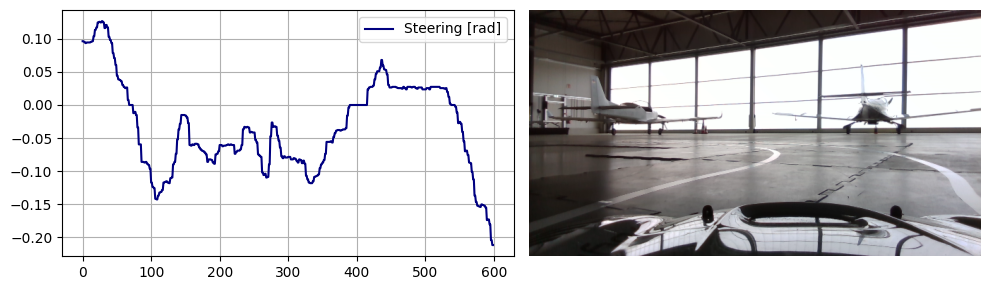

In [9]:
# Create a figure with two side-by-side subplots
fig, (ax_left, ax_right) = plt.subplots(1, 2, figsize=(10, 3))

# Plot the ground-truth steering angles over time
ax_left.plot(true_angles, color="navy", label="Steering [rad]")
ax_left.grid(True)                    # Add grid for better readability
ax_left.legend(loc="upper right")      # Show legend in the top-left corner

# Display one example camera image from the dataset
ax_right.imshow(images[0], aspect="auto")
ax_right.axis("off")                  # Hide axes for a clean image view

# Adjust layout so plots do not overlap
plt.tight_layout()

# Render the figure
plt.show()

## A simple Lane Follower Pipeline

### Debugging utilities  
These helper functions are used to visualize intermediate results and inspect the internal state of the pipeline.

In [10]:
def draw_box(image, im_canny, corners, color=(0, 255, 0), thickness = 2):

    result = image.copy()

    # Extract the coordinates from the corners tuple
    x1, x2, y1, y2 = corners

    # Draw the box on the image
    cv2.rectangle(result, (x1, y1), (x2, y2), color=color, thickness=thickness)

    # Extract the patch from the grayscale image
    patch = cv2.cvtColor(im_canny, cv2.COLOR_GRAY2RGB)[y1:y2, x1:x2, :]

    # Replace the corresponding region in the RGB image with the patch
    result[y1:y2, x1:x2, :] = patch

    return result

### Algorithm building blocks  
This section defines the reusable functions that make up the lane follower.


In [38]:
def get_corners(cx, cy, win_w, win_h, image_w = 640, image_h = 360):
    # Calculate the search window coordinates, ensuring they are within image bounds
    x1 = max(0, int(cx - win_w / 2))
    y1 = max(0, int(cy - win_h / 2))
    x2 = min(image_w, x1 + win_w)
    y2 = min(image_h, y1 + win_h)
    return x1, x2, y1, y2

def preprocess_image(image, canny_min, canny_max, kernel):

    # Convert to grayscale
    im_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Apply Gaussian blur to the grayscale image
    im_blur = cv2.GaussianBlur(im_gray, kernel, 0)

    # Apply Canny edge detection to the preprocessed image
    im_canny = cv2.Canny(im_blur, canny_min, canny_max) # [0 or 255]

    return im_canny

def update_window(corners, im_canny):
    # Adjust window center by detecting lane line pixels in the image patch
    # Success means pixels were found and a new center is calculated

    x1, x2, y1, y2 = corners

    # Extract the relevant image patch and identify non-zero pixels (lane line pixels)
    patch = im_canny[y1:y2, x1:x2]

    x2 = x1 + np.searchsorted(np.cumsum(np.sum(patch > 0, axis=0)), 240)
    patch = im_canny[y1:y2, x1:x2]

    _, xs = np.nonzero(patch)


    # Check if any lane line pixels are detected
    # If not, return False along with the current center
    if len(xs) == 0:
        return False, win_x


    # Calculate the new center based on the mean of the detected pixels
    updated_center = int(x1 + np.mean(xs))

    return True, updated_center

def compute_offset(win_x, half_road_width, veh_xcenter):
    # Estimate the road center from the tracked lane position
    pox_x = win_x - half_road_width

    # Compute how far the vehicle is from the road center (in pixels)
    offset_px = pox_x - veh_xcenter

    # This offset is the control error used for steering
    return offset_px

def predict_steering(offsets, kp=1.0, bias=0.0):
    # Proportional controller: map lateral offsets to steering angles
    return kp * offsets + bias


### Road Follower Setup   
These values control how images are processed and how the lane is tracked in pixel space.

In [28]:
# Image and window
im_width = 640      # image width
im_height = 360     # image height
win_x = 610         # window x position
win_y = 260         # window y position
win_w = 90          # window width
win_h = 30          # window height

# Vehicle position
veh_xcenter = 380   # vehicle center in image

# Canny edge detection
canny_min = 30      # lower threshold
canny_max = 90      # upper threshold
kernel = (7, 7)     # smoothing kernel

# Road geometry
road_width_px = 490
half_road_width = road_width_px // 2

### Running the full pipeline
Here we run the complete lane-following pipeline on the recorded data.

> **Note:** `kp` and `bias` are set so the controller does not modify the signal yet, and will be tuned in the next step.



In [20]:
predicted_angles = []

# Run the full pipeline on each frame
for im in images:
    im_canny = preprocess_image(im, canny_min, canny_max, kernel) # detect edges

    corners = get_corners(win_x, win_y, win_w, win_h, im_width, im_height) # convert window from (x, y, w, h) to (x1, x2, y1, y2)
    success, win_x = update_window(corners, im_canny) # track lane

    if success:
        offset_px = compute_offset(win_x, half_road_width, veh_xcenter)  # vehicle offset
        # kp=1 and bias=0 for now, so this does not change the value
        # kp and bias will be tuned later
        prediction = predict_steering(offset_px) # steering angle
        predicted_angles.append(prediction)
    else:
        predicted_angles.append(np.nan) # no detection

# Convert to NumPy array for further analysis
predicted_angles = np.asarray(predicted_angles, dtype=float)


### Running and inspecting the pipeline  
We run the full algorithm and visualize its internal state to better understand and debug it.

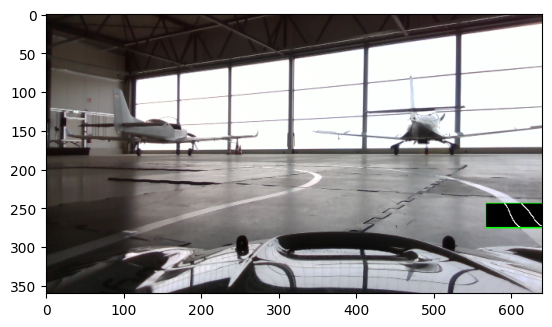

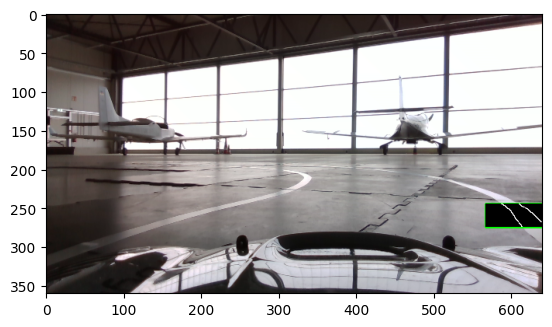

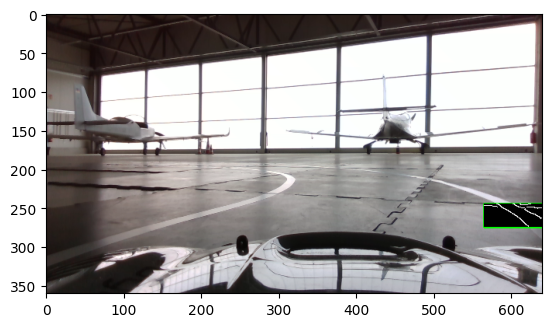

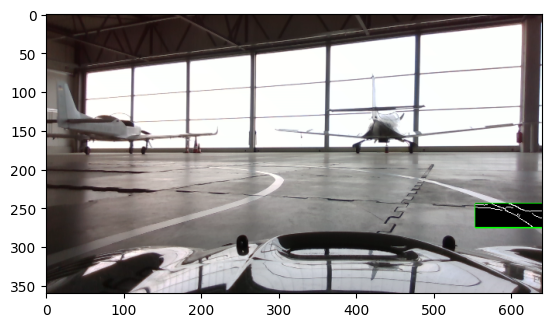

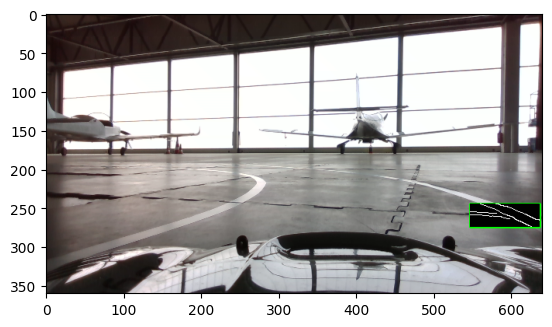

...

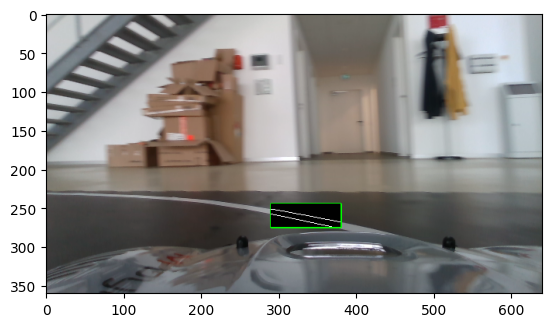

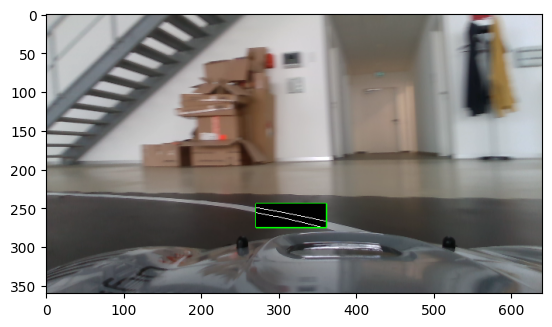

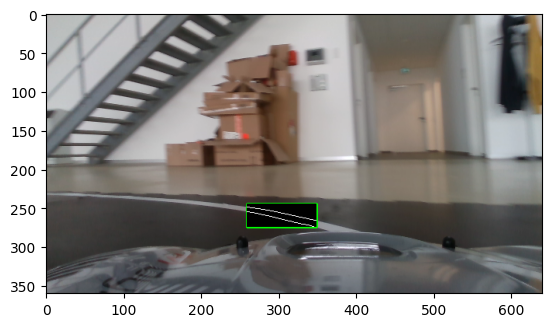

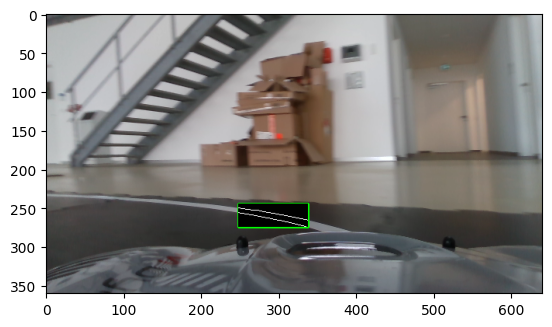

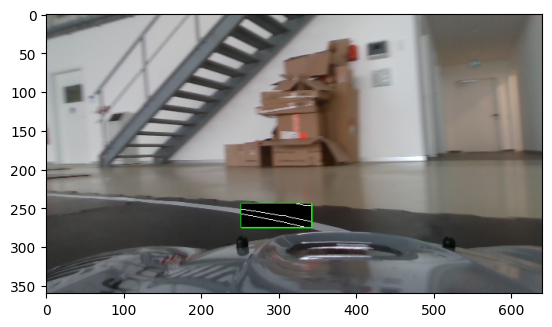

In [29]:
# !!! Warning: re-run the Road Follower Setup cell before this to reset win_x

predicted_angles = []

# Run the full pipeline on each frame
for i, im in enumerate(images):
    im_canny = preprocess_image(im, canny_min, canny_max, kernel) # detect edges

    corners = get_corners(win_x, win_y, win_w, win_h, im_width, im_height) # convert window from (x, y, w, h) to (x1, x2, y1, y2)
    success, win_x = update_window(corners, im_canny) # track lane

    result = draw_box(im, im_canny, get_corners(win_x, win_y, win_w, win_h))

    if i % 5 == 0:
      plt.imshow(result)
      plt.show()

    if success:
        offset_px = compute_offset(win_x, half_road_width, veh_xcenter)  # vehicle offset
        # kp=1 and bias=0 for now, so this does not change the value
        # kp and bias will be tuned later
        prediction = predict_steering(offset_px) # steering angle
        predicted_angles.append(prediction)
    else:
        predicted_angles.append(np.nan) # no detection

# Convert to NumPy array for further analysis
predicted_angles = np.asarray(predicted_angles, dtype=float)

## Evaluating and tuning the controller  
Here we compare the predicted steering to the ground truth and adjust the controller gains.


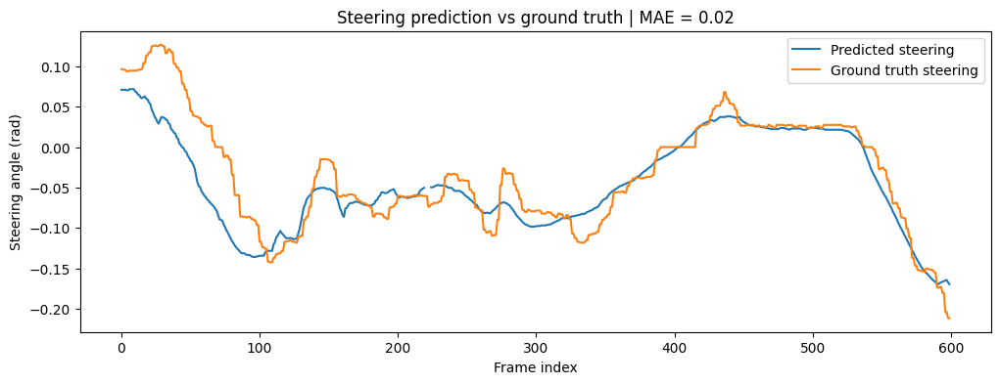

In [37]:
# Proportional gain controlling how strongly we react to lateral error
kp = 7.5e-4

# Constant steering bias (trim) shifting the neutral point
bias = 0.08

tuned_steering = predict_steering(predicted_angles, kp, bias) # steering angle

# Mean Absolute Error between prediction and ground truth
mae = np.nanmean(np.abs(tuned_steering - true_angles))

plt.figure(figsize=(12, 4))
plt.plot(tuned_steering, label="Predicted steering")
plt.plot(true_angles, label="Ground truth steering")
plt.xlabel("Frame index")
plt.ylabel("Steering angle (rad)")
plt.title(f"Steering prediction vs ground truth | MAE = {mae:.2f}")
plt.legend()
plt.show()
